In [95]:
import matplotlib.pyplot as plt 
import seaborn as sns
import numpy as np 
import pandas as pd
from scipy import stats 
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB 
from sklearn.metrics import accuracy_score
#dataset = pd.read_csv(r"C:\Users\evgenija\Downloads\archive\Wine.csv")
#dataset
# dataset = pd.read_csv("Wine.csv")
# dataset.head(100)

dataset = datasets.load_wine()

X = dataset.data # Матрица која ги содржи атрибутите на примероците од податочното множество. Секој ред соодвествува со една инстанца, а секоја колона соодветсвува на еден атрибут.
y = dataset.target # Вектор од вредностите на целната променлива за секоја инстанца од податочното множество.

target_names = dataset.target_names # листа со различните вредности (класи) на целната променлива
feature_names = dataset.feature_names # листа со имињата на атрибутите

number_of_classes = len(target_names) # Број на различни класи. Може да се најде и преку np.unique(y)
number_of_features = len(feature_names)  # Број на атрибути. Може да се најде и преку X.shape[1]
number_of_instances = X.shape[0]

print("Број и имиња на класи:", number_of_classes, target_names) 
print("Број и имиња на атрибути:", number_of_features, feature_names)
print("Број на податочни примероци:", number_of_instances)

Број и имиња на класи: 3 ['class_0' 'class_1' 'class_2']
Број и имиња на атрибути: 13 ['alcohol', 'malic_acid', 'ash', 'alcalinity_of_ash', 'magnesium', 'total_phenols', 'flavanoids', 'nonflavanoid_phenols', 'proanthocyanins', 'color_intensity', 'hue', 'od280/od315_of_diluted_wines', 'proline']
Број на податочни примероци: 178


In [27]:
dataset.describe()

,Class,Alcohol,Malic acid,Ash,Alcalinity of ash,Magnesium,Total phenols,Flavanoids,Nonflavanoid phenols,Proanthocyanins,Color intensity,Hue,OD280/OD315 of diluted wines,Proline
count,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000
mean,1.938202,13.000618,2.336348,2.366517,19.494944,99.741573,2.295112,2.029270,0.361854,1.590899,5.058090,0.957449,2.611685,746.893258
std,0.775035,0.811827,1.117146,0.274344,3.339564,14.282484,0.625851,0.998859,0.124453,0.572359,2.318286,0.228572,0.709990,314.907474
min,1.000000,11.030000,0.740000,1.360000,10.600000,70.000000,0.980000,0.340000,0.130000,0.410000,1.280000,0.480000,1.270000,278.000000
25%,1.000000,12.362500,1.602500,2.210000,17.200000,88.000000,1.742500,1.205000,0.270000,1.250000,3.220000,0.782500,1.937500,500.500000
50%,2.000000,13.050000,1.865000,2.360000,19.500000,98.000000,2.355000,2.135000,0.340000,1.555000,4.690000,0.965000,2.780000,673.500000
75%,3.000000,13.677500,3.082500,2.557500,21.500000,107.000000,2.800000,2.875000,0.437500,1.950000,6.200000,1.120000,3.170000,985.000000
max,3.000000,14.830000,5.800000,3.230000,30.000000,162.000000,3.880000,5.080000,0.660000,3.580000,13.000000,1.710000,4.000000,1680.000000


In [31]:
dataset.isnull().sum()
#falat li nekoi vrednosti?

Class                           0
Alcohol                         0
Malic acid                      0
Ash                             0
Alcalinity of ash               0
Magnesium                       0
Total phenols                   0
Flavanoids                      0
Nonflavanoid phenols            0
Proanthocyanins                 0
Color intensity                 0
Hue                             0
OD280/OD315 of diluted wines    0
Proline                         0
dtype: int64

In [33]:
dataset.value_counts("Class")

Class
2    71
1    59
3    48
Name: count, dtype: int64

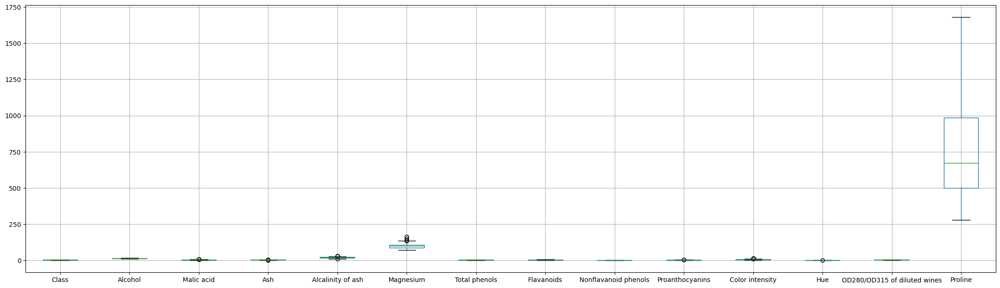

In [63]:
fig = plt.figure(figsize=(27, 7.5))
dataset.boxplot()
plt.show()

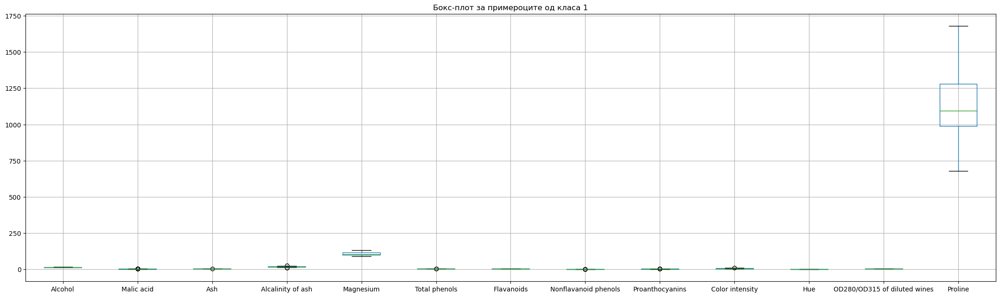

In [65]:
fig = plt.figure(figsize=(27, 7.5))
dataset[dataset.Class==1].drop(['Class'], axis=1).boxplot()
plt.title('Бокс-плот за примероците од класа 1')
plt.show()

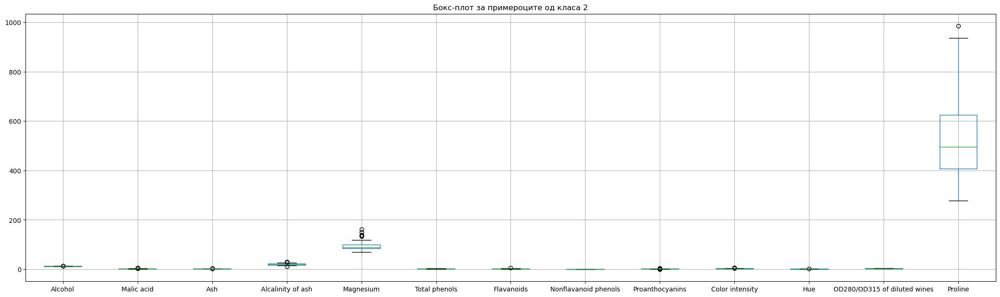

In [67]:
fig = plt.figure(figsize=(27, 7.5))
dataset[dataset.Class==2].drop(['Class'], axis=1).boxplot()
plt.title('Бокс-плот за примероците од класа 2')
plt.show()

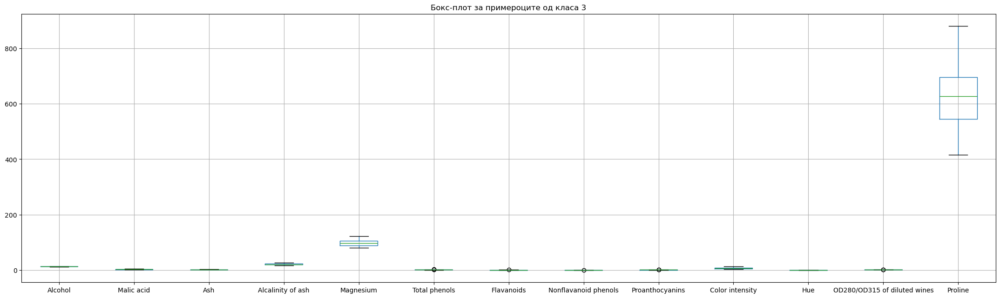

In [85]:
fig = plt.figure(figsize=(27, 7.5))
dataset[dataset.Class==3].drop(['Class'], axis=1).boxplot()
plt.title('Бокс-плот за примероците од класа 3')
plt.show()

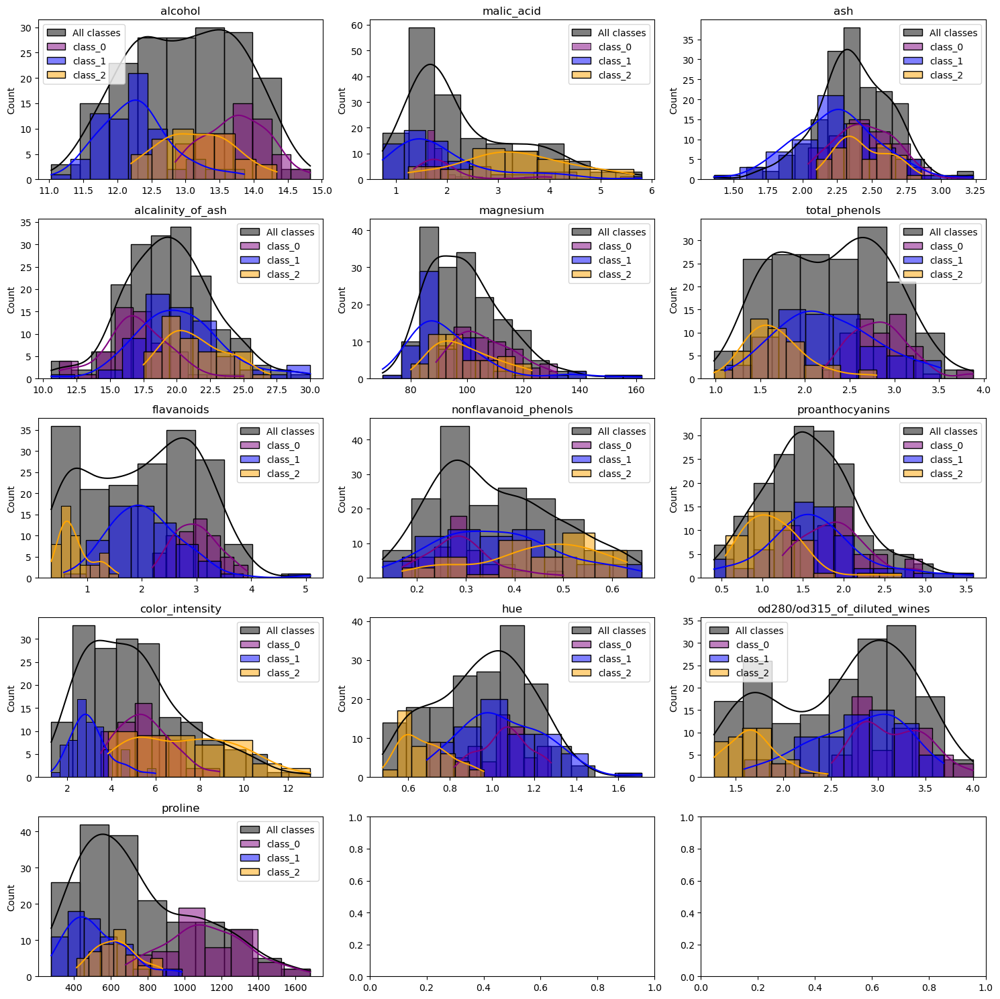

In [107]:
colors = ['purple', 'blue', 'orange']
ncols = 3 
nrows = (number_of_features + ncols - 1) // ncols  # Kalkulacija na potreben broj na redovi!!!

fig = plt.figure(figsize=(15, 15))
fig.subplots(nrows=nrows, ncols=ncols)

for feature in range(number_of_features):
    ax = plt.subplot(nrows, ncols, feature + 1)  
    plt.title(feature_names[feature])  

    sns.histplot(X[:, feature], color='black', label='All classes', kde=True, stat="count")

    for Class in range(number_of_classes):
        sns.histplot(X[y == Class, feature], color=colors[Class], label=target_names[Class], kde=True, stat="count")

    plt.legend()

#za da izbegneme overlap
plt.tight_layout()

plt.show()

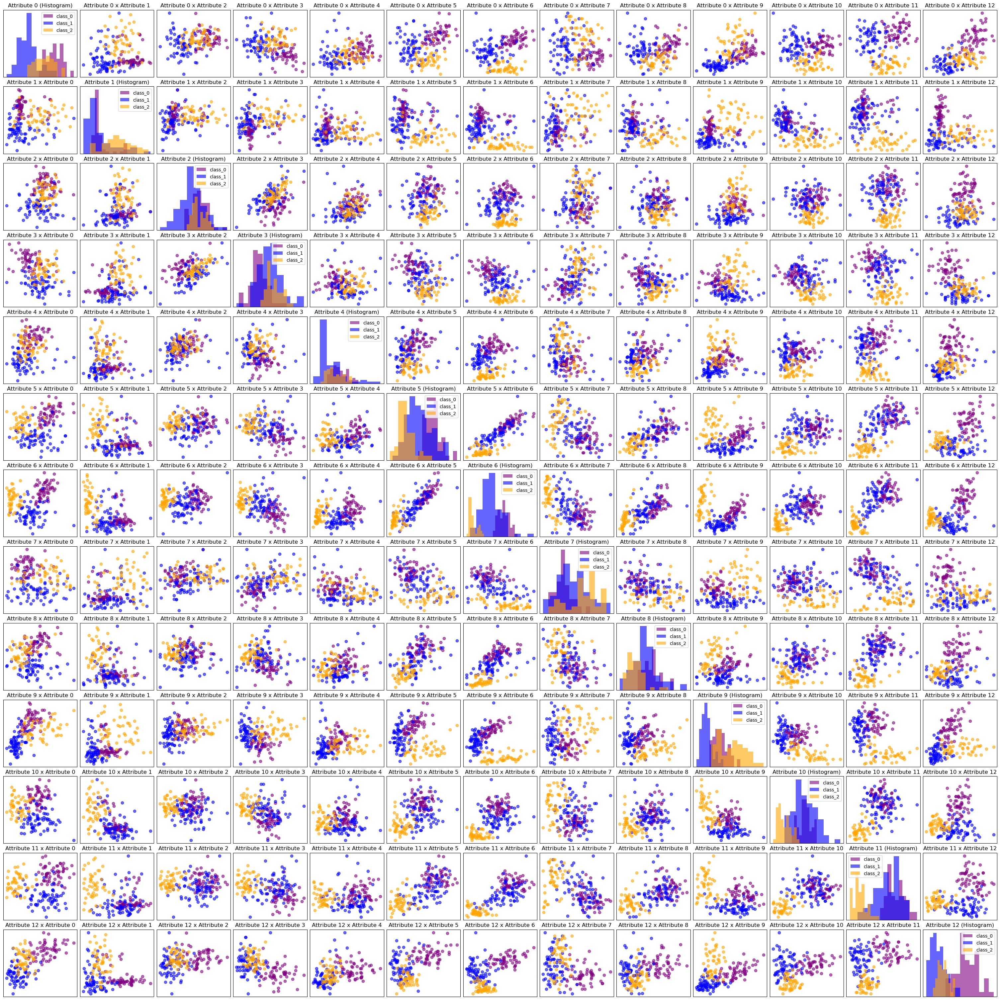

In [113]:
colors = ['purple', 'blue', 'orange']

number_of_features = len(feature_names)  # Number of features
number_of_classes = len(target_names)  # Number of classes

# Create a figure with a grid layout of subplots
fig = plt.figure(figsize=(30, 30), layout='constrained')
fig.subplots(nrows=number_of_features, ncols=number_of_features)

# Loop through each pair of features (i, j)
for feature_i in range(number_of_features):
    for feature_j in range(number_of_features):  
        ax = plt.subplot(number_of_features, number_of_features, number_of_features * feature_i + feature_j + 1)

        if feature_i == feature_j:  # Diagonal: Plot histograms for individual features
            for color, i, target_name in zip(colors, [0, 1, 2], target_names):
                # Plot histograms for each class
                plt.hist(X[y == i, feature_i], alpha=.6, color=color, label=target_name)
            plt.title(f"Attribute {feature_i} (Histogram)")
            plt.legend()
        else:  # Off-diagonal: Plot scatter plot for feature pairs
            for color, i, target_name in zip(colors, [0, 1, 2], target_names):
                # Plot scatter plot between pairs of features for each class
                plt.scatter(X[y == i, feature_i], X[y == i, feature_j], alpha=.6, color=color, label=target_name)
            plt.title(f"Attribute {feature_i} x Attribute {feature_j}")
        
        # Remove axis ticks for clarity
        plt.xticks(())
        plt.yticks(())

# Show the plot
plt.show()

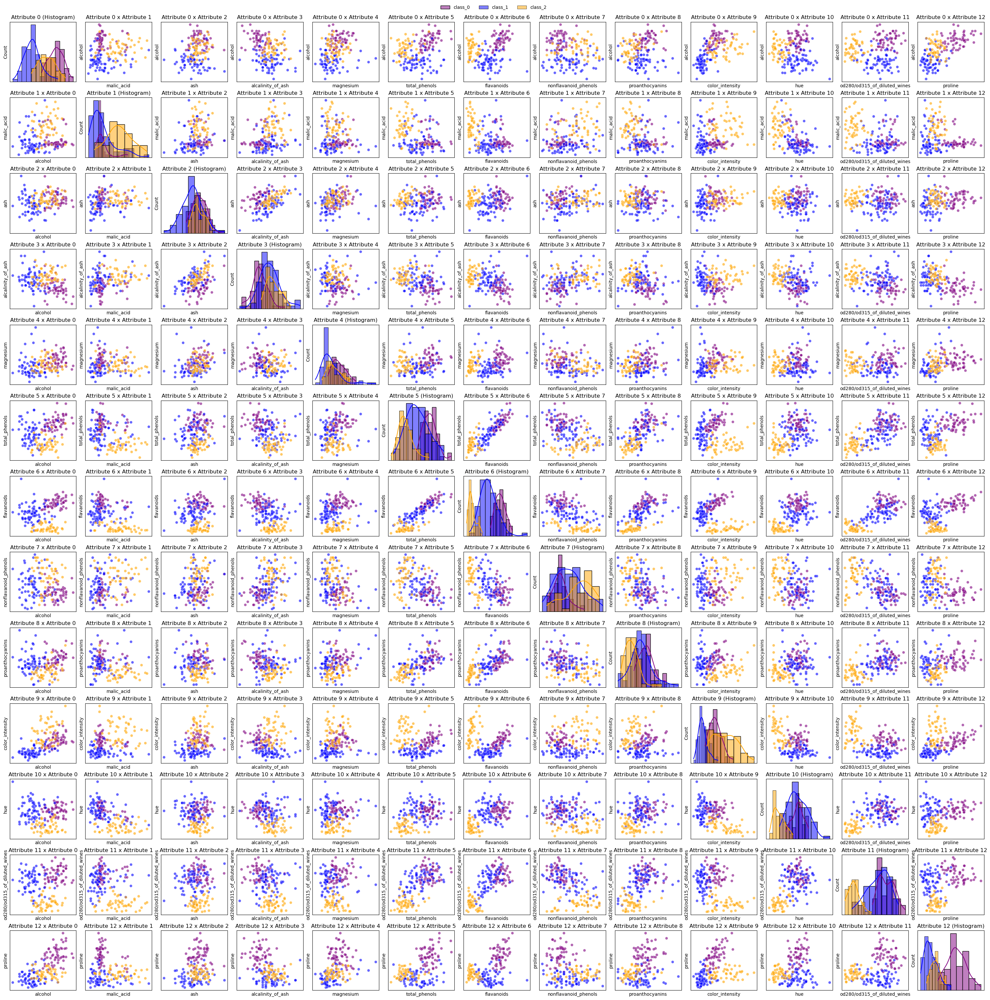

In [117]:
colors = ['purple', 'blue', 'orange']

number_of_features = len(feature_names)  # Number of features
number_of_classes = len(target_names)  # Number of classes

# Create a DataFrame for easier indexing
df = pd.DataFrame(X, columns=feature_names)
df['target'] = y  # Add target column to the DataFrame for color coding in scatterplots

# Create a figure with a grid layout of subplots
fig = plt.figure(figsize=(30, 30), layout='constrained')
fig.subplots(nrows=number_of_features, ncols=number_of_features)

# Loop through each pair of features (i, j)
for feature_i in range(number_of_features):
    for feature_j in range(number_of_features):  
        ax = plt.subplot(number_of_features, number_of_features, number_of_features * feature_i + feature_j + 1)

        if feature_i == feature_j:  # Diagonal: Plot histograms for individual features
            for color, i, target_name in zip(colors, [0, 1, 2], target_names):
                sns.histplot(X[y == i, feature_i], color=color, label=target_name, kde=True, legend=True) # Histogram
            plt.title(f"Attribute {feature_i} (Histogram)")
        else:  # Off-diagonal: Plot scatter plot for feature pairs
            sns.scatterplot(data=df, x=df.columns[feature_j], y=df.columns[feature_i], hue='target', alpha=.6, palette=colors, legend=False)
            plt.title(f"Attribute {feature_i} x Attribute {feature_j}")

        # Remove axis ticks for clarity
        plt.xticks(())
        plt.yticks(())

# Add a single legend for the entire figure
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, target_names, loc='lower center', bbox_to_anchor=(.5, 1), ncol=3, frameon=False)

# Show the plot
plt.show()

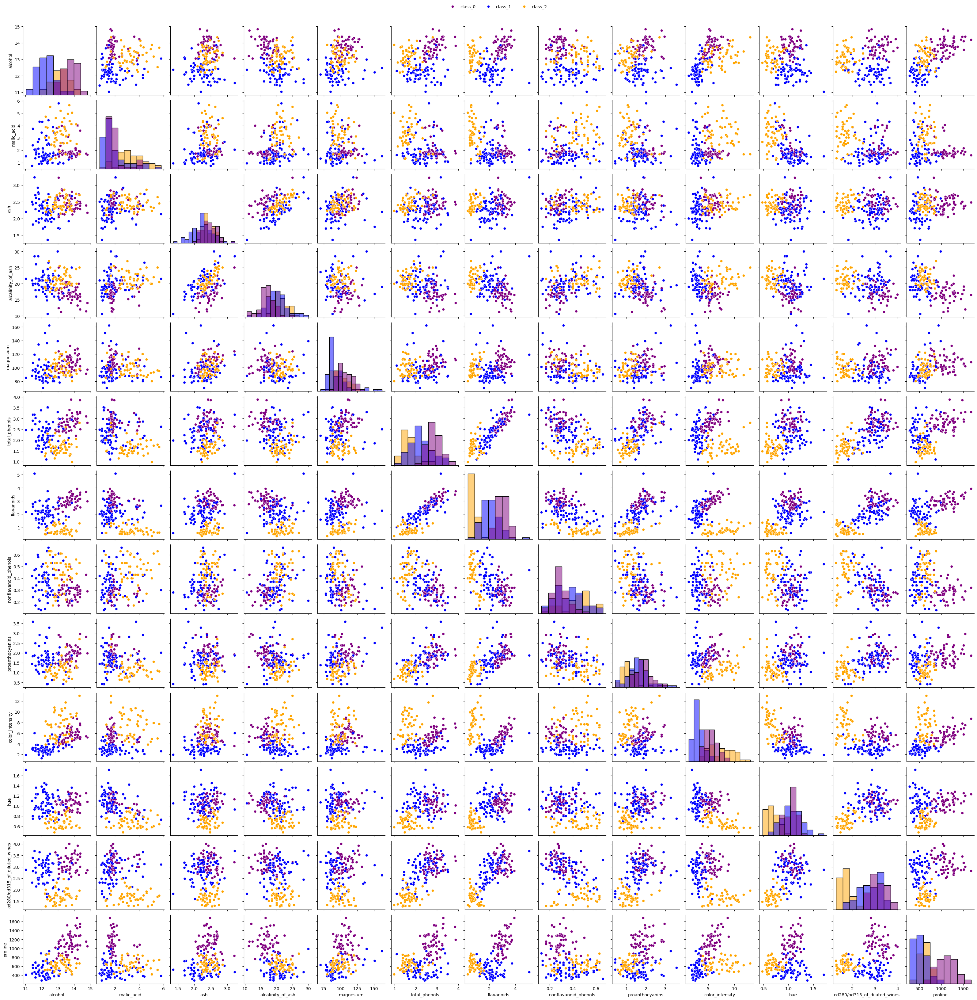

In [119]:
colors = ['purple', 'blue', 'orange']

# Create a DataFrame for easier indexing
df = pd.DataFrame(X, columns=feature_names)
df['target'] = y  # Add target column to the DataFrame for color coding in pairplot

# Create the pairplot
g = sns.pairplot(df, hue="target", diag_kind="hist", palette=colors)

# Move the legend to a better position
sns.move_legend(g, "lower center", bbox_to_anchor=(.5, 1), ncol=3, title=None)

# Adjust the legend labels to match the target names
for t, l in zip(g._legend.texts, target_names):
    t.set_text(l)

# Show the plot
plt.show()

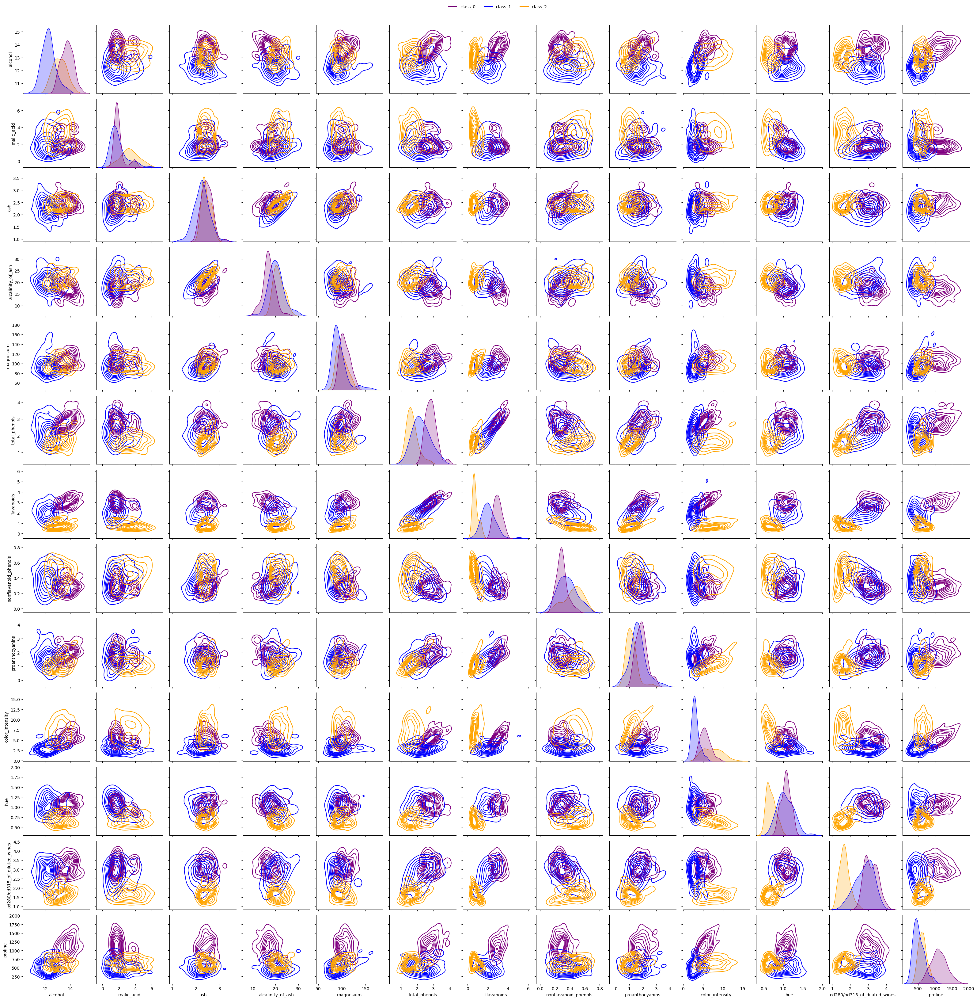

In [121]:
df = pd.DataFrame(X, columns=feature_names)
df['target'] = y  # Add the target (class) column

# Define the colors for each class (target)
colors = ['purple', 'blue', 'orange']

# Create the pairplot with KDE for feature distributions
g = sns.pairplot(df, hue="target", kind="kde", palette=colors)

# Move the legend to a better position (lower center)
sns.move_legend(g, "lower center", bbox_to_anchor=(.5, 1), ncol=3, title=None)

# Update the legend labels to match your target names
for t, l in zip(g._legend.texts, target_names):
    t.set_text(l)

# Show the plot
plt.show()

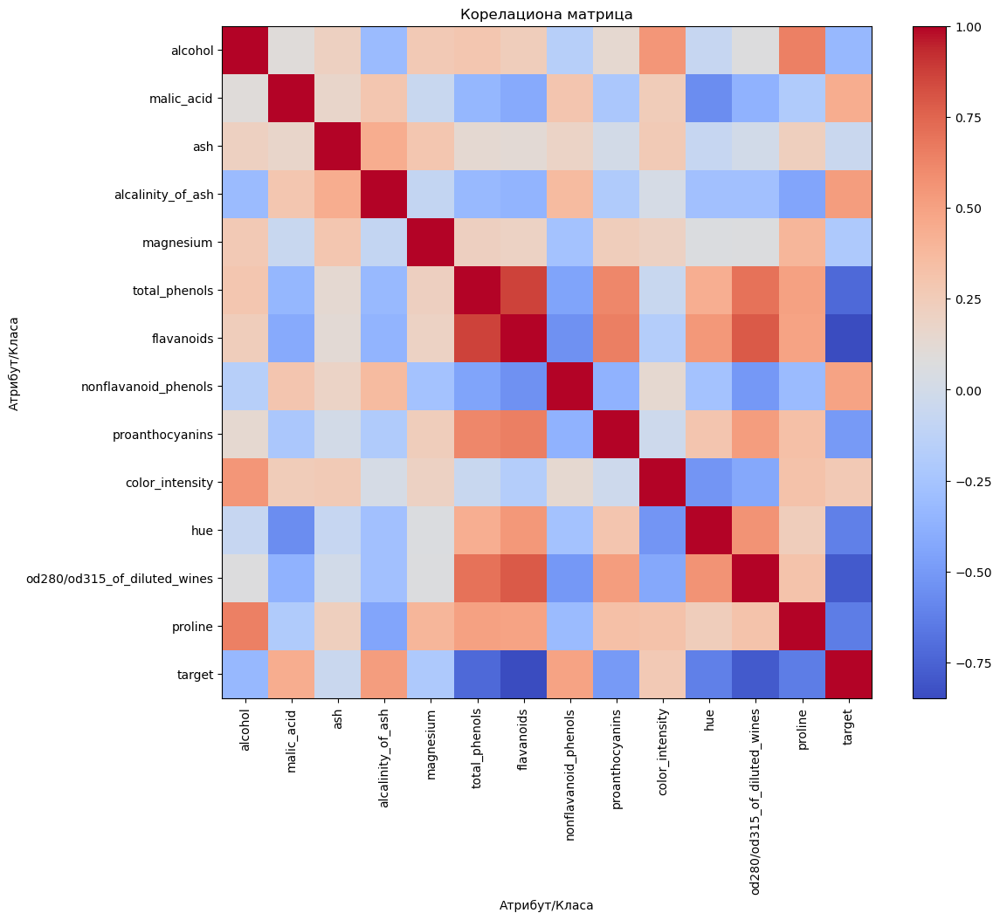

In [127]:
number_of_features = X.shape[1]
number_of_classes = len(np.unique(y))
target_names = dataset.target_names

# Initialize a correlation matrix to store the correlations
# The matrix will have size (number_of_features + 1, number_of_features + 1)
# to include both features and the target variable
correlation_matrix = np.zeros((number_of_features + 1, number_of_features + 1))
for feature_i in range(number_of_features):
    for feature_j in range(number_of_features):
        corr, _ = stats.pearsonr(X[:, feature_i], X[:, feature_j])  # Calculate correlation
        correlation_matrix[feature_i][feature_j] = corr  # Store the result

# Calculate Pearson correlation between each feature and the target variable
for feature_i in range(number_of_features):
    target_i = number_of_features  # The last row and column represent the target variable
    corr, _ = stats.pearsonr(X[:, feature_i], y)  # Correlation between feature and target
    correlation_matrix[feature_i][target_i] = corr
    correlation_matrix[target_i][feature_i] = corr

# Calculate Pearson correlation between the target and itself (which will be 1)
corr, _ = stats.pearsonr(y, y)
correlation_matrix[target_i][target_i] = corr

# Visualize the correlation matrix using a heatmap
plt.figure(figsize=(12, 10))
plt.imshow(correlation_matrix, cmap='coolwarm', aspect='auto', interpolation='none')
plt.colorbar()
plt.xticks(ticks=np.arange(number_of_features + 1), labels=list(dataset.feature_names) + ['target'], rotation=90)
plt.yticks(ticks=np.arange(number_of_features + 1), labels=list(dataset.feature_names) + ['target'])
plt.xlabel("Атрибут/Класа")
plt.ylabel("Атрибут/Класа")
plt.title("Корелациона матрица")
plt.show()

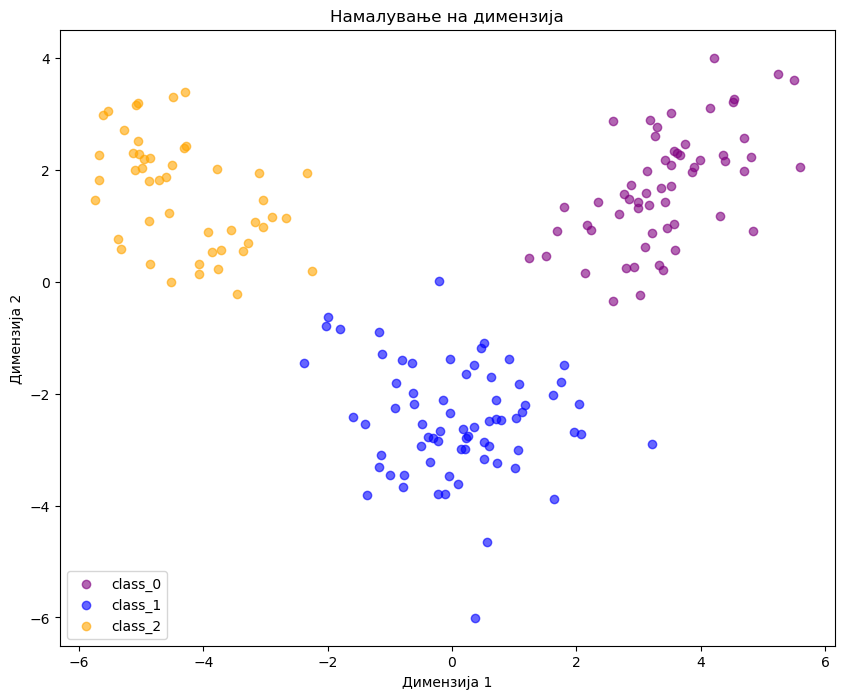

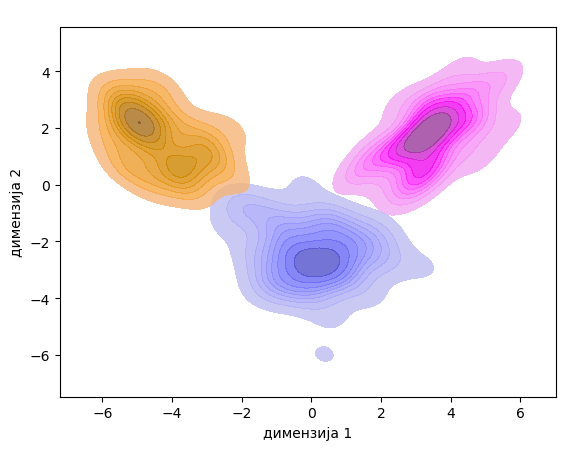

In [129]:
colors = ['purple', 'blue', 'orange']

# Step 1: Apply Linear Discriminant Analysis (LDA) to reduce dimensionality to 2
LDA_reduce = LinearDiscriminantAnalysis(n_components=2)  # Set the number of components to 2
LDA_reduce.fit(X, y)  # Fit the LDA model on the data
X_reduced = LDA_reduce.transform(X)  # Transform the input data X to the new 2D space

# Step 2: Visualize the reduced dataset in 2D using a scatter plot
plt.figure(figsize=(10, 8))

for color, i, target_name in zip(colors, [0, 1, 2], target_names):
    plt.scatter(X_reduced[y == i, 0], X_reduced[y == i, 1], alpha=.6, color=color, label=target_name)
    
plt.legend()
plt.xlabel("Димензија 1")
plt.ylabel("Димензија 2")
plt.title('Намалување на димензија')
plt.show()

# Step 3: Prepare the data for KDE plot
df = pd.DataFrame(X_reduced, columns=["димензија 1", "димензија 2"])  # Add the reduced dimensions as columns
df['target'] = y  # Add the target column for hue in the KDE plot

# Step 4: Create a KDE plot with Seaborn to visualize the density
g = sns.kdeplot(data=df, x="димензија 1", y="димензија 2", hue="target", palette=colors, alpha=0.8, fill=True)

# Step 5: Adjust the legend for clarity
handles, labels = g.get_legend_handles_labels()
g.legend(handles, target_names, labelcolor=colors, loc='lower center', bbox_to_anchor=(.5, 1), ncol=3, frameon=False)

plt.show()

In [131]:
# Apply Linear Discriminant Analysis (LDA) to reduce dimensionality to 2
LDA_reduce = LinearDiscriminantAnalysis(n_components=2)  # Set the number of components to 2
LDA_reduce.fit(X, y)  # Fit the LDA model on the data
X_reduced = LDA_reduce.transform(X)  # Transform the input data X to the new 2D space

# Step 1: Train-test split for the original dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)  # 30% test set, 70% train set

# Step 2: Train-test split for the reduced dataset (after LDA)
X_reduced_train, X_reduced_test, y_reduced_train, y_reduced_test = train_test_split(X_reduced, y, test_size=0.3, random_state=42)  # 30% test set, 70% train set


In [133]:
QDA = QuadraticDiscriminantAnalysis() # иницијализација на моделот
QDA.fit(X_train, y_train); # нагодување на моделот на податоците од тренинг множеството

In [135]:
print("Приорните веројатности на класите се",QDA.priors_)

Приорните веројатности на класите се [0.32258065 0.40322581 0.27419355]


In [139]:
y_pred = QDA.predict(X_test) # предвидување на лабелите од тест множеството со користење на нагодениот модел
QDA_accuracy = accuracy_score(y_test, y_pred) # пресметување на точност на предвидените лабели од тест множеството

print("Точноста на класификацијата со методот QDA во оригиналното 'Wine' податочно множество е",round(QDA_accuracy,3))

Точноста на класификацијата со методот QDA во оригиналното 'Wine' податочно множество е 0.981


In [151]:
LDA = LinearDiscriminantAnalysis() # иницијализација на моделот
LDA.fit(X_train, y_train) # нагодување на моделот на податоците од тренинг множеството
y_pred = LDA.predict(X_test) # предвидување на лабелите од тест множеството со користење на нагодениот модел
LDA_accuracy = accuracy_score(y_test, y_pred) # пресметување на точноста на предвидените лабели од тест множеството

print("Точноста на класификацијата со методот LDA во оригиналното 'Wine' податочно множество е", round(LDA_accuracy,3)) 

Точноста на класификацијата со методот LDA во оригиналното 'Wine' податочно множество е 1.0


In [149]:
GNB = GaussianNB() # иницијализација на моделот
GNB.fit(X_train, y_train) # нагодување на моделот на податоците од тренинг множеството
y_pred = GNB.predict(X_test) # предвидување на лабелите од тест множеството со користење на нагодениот модел
GNB_accuracy = accuracy_score(y_test, y_pred) # пресметување на точноста на предвидените лабели од тест множеството

print("Точноста на класификацијата со Гаусовиот наивен Баесов класификатор во оригиналното 'Wine' податочно множество е",round(GNB_accuracy,3))

Точноста на класификацијата со Гаусовиот наивен Баесов класификатор во оригиналното 'Wine' податочно множество е 1.0


Точноста на класификацијата со методот QDA во редуцираното 'Wine' податочно множество е 1.0


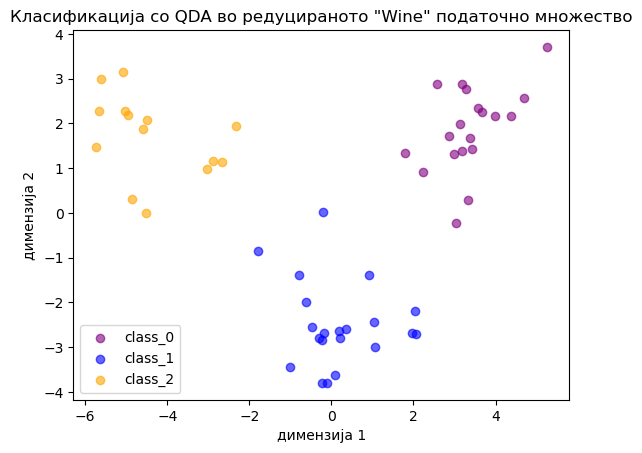

In [169]:
QDA_reduced = QuadraticDiscriminantAnalysis() # иницијализација на моделот
QDA_reduced.fit(X_reduced_train, y_reduced_train) # нагодување на моделот на податоците од тренинг множеството
y_pred = QDA_reduced.predict(X_reduced_test) # предвидување на лабелите од тест множеството со користење на нагодениот модел
QDA_reduced_accuracy = accuracy_score(y_test, y_pred) # пресметување на точноста на предвидените лабели од тест множеството
print("Точноста на класификацијата со методот QDA во редуцираното 'Wine' податочно множество е",round(QDA_reduced_accuracy,3)) 

# Визуелизација на тест множеството и грешките при класификацијата
plt.figure()
for color, i, target_name in zip(colors, [0, 1, 2], target_names):
    plt.scatter(X_reduced_test[y_test == i, 0], X_reduced_test[y_test == i, 1], alpha=.6, color=color,
                label=target_name)

incorrect = y_pred!=y_reduced_test
for i in range(len(incorrect)):
    if(incorrect[i]==True):
        plt.scatter(X_reduced_test[i][0], X_reduced_test[i][1], alpha=.6, color="black")
        
plt.legend()
plt.xlabel("димензија 1")
plt.ylabel("димензија 2")
plt.title('Класификација со QDA во редуцираното "Wine" податочно множество');

Точноста на класификацијата со методот LDA во редуцираното 'Wine' податочно множество е 1.0


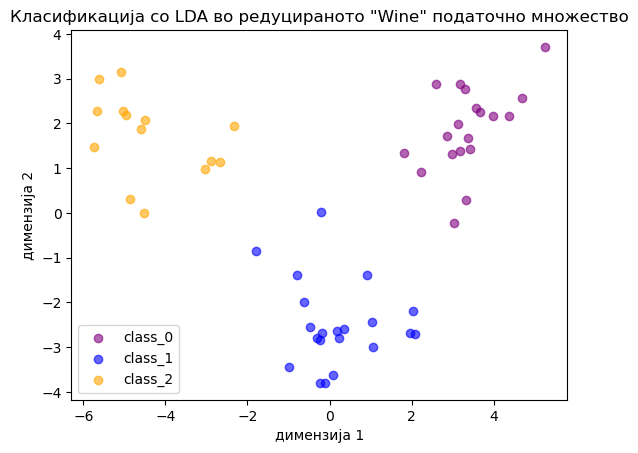

In [167]:
LDA_reduced = LinearDiscriminantAnalysis(solver='lsqr') # иницијализација на моделот
LDA_reduced.fit(X_reduced_train, y_reduced_train) # нагодување на моделот на податоците од тренинг множеството
y_pred = LDA_reduced.predict(X_reduced_test) # предвидување на лабелите од тест множеството со користење на нагодениот модел
LDA_reduced_accuracy = accuracy_score(y_test, y_pred) # пресметување на точноста на предвидените лабели од тест множеството
print("Точноста на класификацијата со методот LDA во редуцираното 'Wine' податочно множество е",round(LDA_reduced_accuracy,3)) 

# Визуелизација на тест множеството и грешките при класификацијата
plt.figure()
for color, i, target_name in zip(colors, [0, 1, 2], target_names):
    plt.scatter(X_reduced_test[y_test == i, 0], X_reduced_test[y_test == i, 1], alpha=.6, color=color,
                label=target_name)

incorrect = y_pred!=y_reduced_test
for i in range(len(incorrect)):
    if(incorrect[i]==True):
        plt.scatter(X_reduced_test[i][0], X_reduced_test[i][1], alpha=.6, color="black")
        
plt.legend()
plt.xlabel("димензија 1")
plt.ylabel("димензија 2")
plt.title('Класификација со LDA во редуцираното "Wine" податочно множество');

Точноста на класификацијата со Гаусов наивен Баесов класификатор во редуцираното 'Wine'податочно множество е 1.0


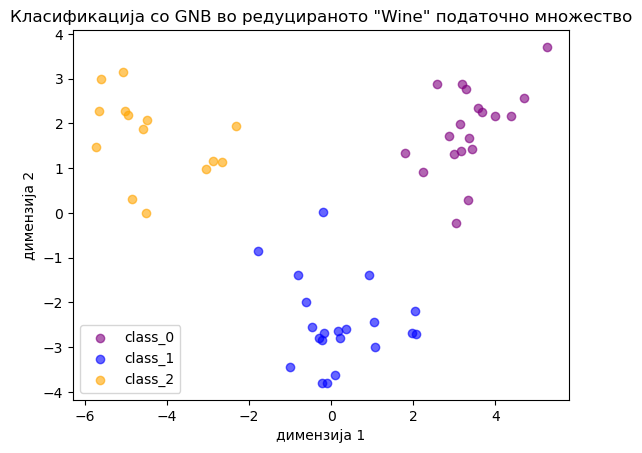

In [165]:
GNB_reduced = GaussianNB() # иницијализација на моделот
GNB_reduced.fit(X_reduced_train, y_reduced_train) # нагодување на моделот на податоците од тренинг множеството
y_pred = GNB_reduced.predict(X_reduced_test) # предвидување на лабелите од тест множеството со користење на нагодениот модел
GNB_reduced_accuracy = accuracy_score(y_test, y_pred) # пресметување на точноста на предвидените лабели од тест множеството
print("Точноста на класификацијата со Гаусов наивен Баесов класификатор во редуцираното 'Wine'податочно множество е",round(GNB_reduced_accuracy,3)) 

# Визуелизација на тест множеството и грешките при класификацијата
plt.figure()
for color, i, target_name in zip(colors, [0, 1, 2], target_names):
    plt.scatter(X_reduced_test[y_test == i, 0], X_reduced_test[y_test == i, 1], alpha=.6, color=color,
                label=target_name)

incorrect = y_pred!=y_reduced_test
for i in range(len(incorrect)):
    if(incorrect[i]==True):
        plt.scatter(X_reduced_test[i][0], X_reduced_test[i][1], alpha=.6, color="black")
        
plt.legend()
plt.xlabel("димензија 1")
plt.ylabel("димензија 2")
plt.title('Класификација со GNB во редуцираното "Wine" податочно множество');


In [171]:
from scipy import linalg
from matplotlib import colors
import matplotlib as mpl

def plot_data(lda, X, y, y_pred):
    splot = plt.subplot(1, 1, 1) 
    
    true = y == y_pred  # Точно предвидени класи
    true0, true1, true2 = true[y == 0], true[y == 1], true[y == 2]
    X0, X1, X2 = X[y == 0], X[y == 1], X[y == 2]
    X0_true, X0_false = X0[true0], X0[~true0]
    X1_true, X1_false = X1[true1], X1[~true1]
    X2_true, X2_false = X2[true2], X2[~true2]

    # Исцртување на примероците од сите класи
    plt.scatter(X0_true[:, 0], X0_true[:, 1], alpha=.6, color="purple",label='setosa')
    plt.scatter(X0_false[:, 0], X0_false[:, 1], marker="x", s=20, color="purple")

    plt.scatter(X1_true[:, 0], X1_true[:, 1],  alpha=.6, color="blue",label='versicolor')
    plt.scatter(X1_false[:, 0], X1_false[:, 1], marker="x", s=20, color="blue")
    
    plt.scatter(X2_true[:, 0], X2_true[:, 1],  alpha=.6, color="orange",label='virginica')
    plt.scatter(X2_false[:, 0], X2_false[:, 1], marker="x", s=20, color="orange")

    # Исцртување на границите на одлука
    nx, ny = 100, 100
    x_min, x_max = plt.xlim()
    y_min, y_max = plt.ylim()
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, nx), np.linspace(y_min, y_max, ny))
    Z = lda.predict_proba(np.c_[xx.ravel(), yy.ravel()])
    Z = Z[:, 1].reshape(xx.shape)
    plt.contour(xx, yy, Z, [0.5],colors="black")

    # Исцртување на средните вредности за сеекоја од класите
    plt.plot(lda.means_[0][0],lda.means_[0][1],"s",color="purple",markersize=15)
    plt.plot(lda.means_[1][0],lda.means_[1][1],"s",color="blue",markersize=15)
    plt.plot(lda.means_[2][0],lda.means_[2][1],"s",color="orange",markersize=15)
    return splot


def plot_ellipse(splot, mean, cov, color):
    v, w = linalg.eigh(cov)
    u = w[0] / linalg.norm(w[0])
    angle = np.arctan(u[1] / u[0])
    angle = 180 * angle / np.pi
    ell = mpl.patches.Ellipse(mean,2*v[0]**0.5,2*v[1]**0.5,angle=180+angle,facecolor=color)
    ell.set_clip_box(splot.axes.bbox)
    ell.set_alpha(0.2)
    splot.add_artist(ell)
    splot.set_xticks(())
    splot.set_yticks(())

def plot_lda_cov(lda, splot):
    plot_ellipse(splot, lda.means_[0], lda.covariance_, "purple")
    plot_ellipse(splot, lda.means_[1], lda.covariance_, "blue")
    plot_ellipse(splot, lda.means_[2], lda.covariance_, "orange")


def plot_qda_cov(qda, splot):
    plot_ellipse(splot, qda.means_[0], qda.covariance_[0], "purple")
    plot_ellipse(splot, qda.means_[1], qda.covariance_[1], "blue")
    plot_ellipse(splot, qda.means_[2], qda.covariance_[2], "orange")

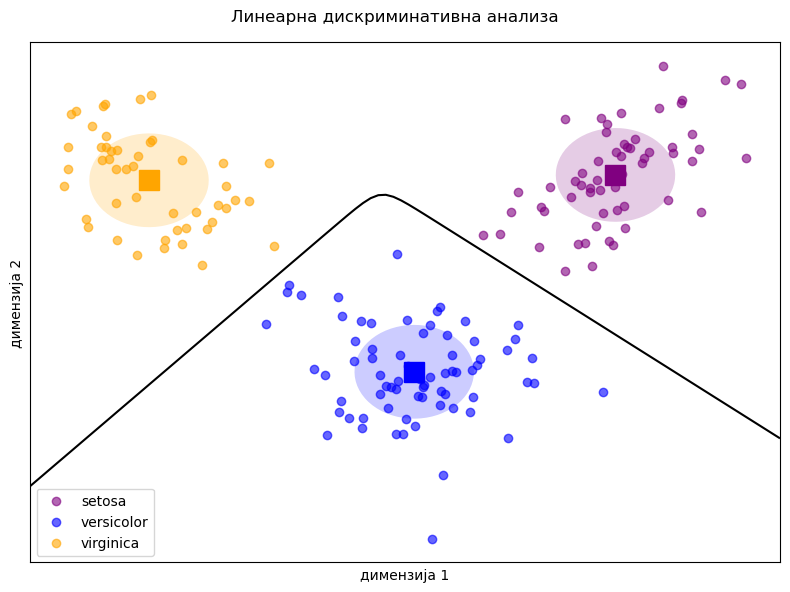

In [173]:
plt.figure(figsize=(8, 6))
plt.suptitle("Линеарна дискриминативна анализа")

lda = LinearDiscriminantAnalysis(solver="svd", store_covariance=True)
y_pred = lda.fit(X_reduced, y).predict(X_reduced)
splot = plot_data(lda, X_reduced, y, y_pred)
plot_lda_cov(lda, splot)
plt.axis("tight")
plt.legend()
plt.xlabel("димензија 1")
plt.ylabel("димензија 2")
plt.tight_layout()
plt.show()

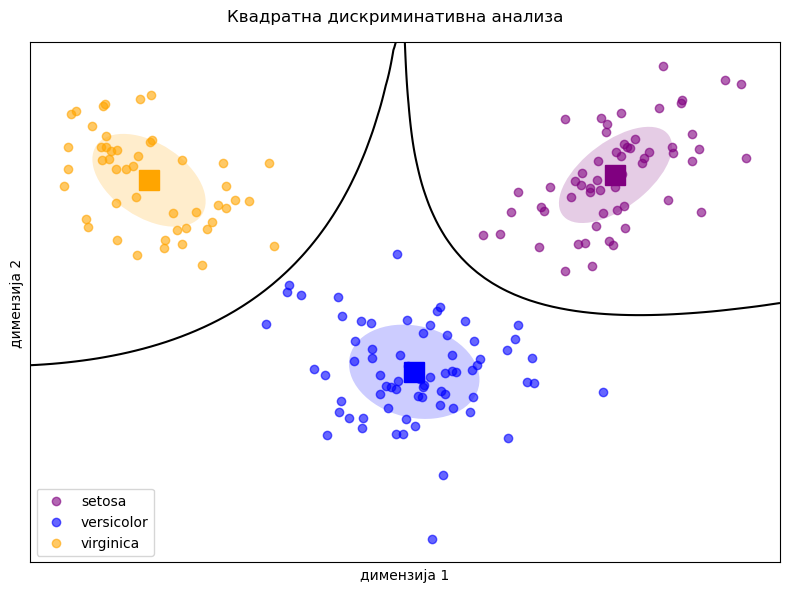

In [175]:
plt.figure(figsize=(8, 6))
plt.suptitle("Квадратна дискриминативна анализа")

qda = QuadraticDiscriminantAnalysis(store_covariance=True)
y_pred = qda.fit(X_reduced, y).predict(X_reduced)
splot = plot_data(qda, X_reduced, y, y_pred)
plot_qda_cov(qda, splot)
plt.axis("tight")
plt.legend()
plt.xlabel("димензија 1")
plt.ylabel("димензија 2")
plt.tight_layout()
plt.show()